### <font color = 'purple'>  DATA 255: HOMEWORK 6: ADVANCED GANs

#### <font color = 'purple'> PART-1 CycleGAN

#### <font color = 'purple'> 1) Load the Monet_to_Photo Dataset using Pytorch.

In [1]:
!pip install torch_snippets torch_summary --quiet

import itertools
from PIL import Image
from torch_snippets import *
from torchvision import transforms
from torchvision.utils import make_grid
from torchsummary import summary
import torch
from torch.utils.data import Dataset, DataLoader
import os
from glob import glob
from random import randint
import torch.nn as nn
import matplotlib.pyplot as plt
from PIL import Image
from IPython.display import display
import time

Opening image at: /kaggle/input/monetdataset/trainA/00012.jpg
(256, 256)


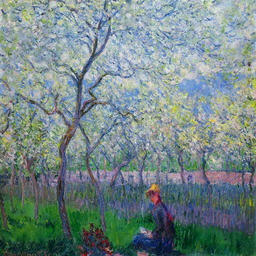

In [2]:
img_path ='/kaggle/input/monetdataset/trainA/00012.jpg'

print(f"Opening image at: {img_path}")
img = Image.open(img_path)
print(img.size)
display(img)

(256, 256)


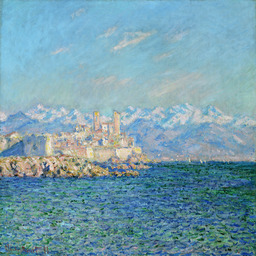

In [3]:
img = Image.open('/kaggle/input/monetdataset/testA/00020.jpg')
print(img.size)
display(img)

In [4]:
IMAGE_SIZE = 256
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f'device: {device}')

device: cuda


<font color = 'blue'> Transforming the images and data augmentation: Added transformations like Resize, random cropping, giving random horizontal flip, color jitter and finally normalise it

In [5]:
transform = transforms.Compose([
    transforms.Resize(int(IMAGE_SIZE*1.33)),
    transforms.RandomCrop((IMAGE_SIZE,IMAGE_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.05),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

<b><font color = 'blue'>  Creating our train and test datset

In [6]:
class Monet2PhotoDataset(Dataset):
    def __init__(self, monet_path, photo_path):
        self.monet = glob(os.path.join(monet_path, '*.jpg'))
        self.photo = glob(os.path.join(photo_path, '*.jpg'))

        print(f'Monet images count: {len(self.monet)}')
        print(f'Photo images count: {len(self.photo)}')

    def __getitem__(self, ix):

        monet_path = self.monet[ix % len(self.monet)]
        photo_path = self.choose(self.photo)
        monet = Image.open(monet_path).convert('RGB')
        photo = Image.open(photo_path).convert('RGB')
        monet = transform(monet)
        photo = transform(photo)
        return monet, photo

    def __len__(self):
        return max(len(self.monet), len(self.photo))

    def choose(self, images):
        return images[randint(0, len(images) - 1)]

    def collate_fn(self, batch): 
        srcs, trgs = list(zip(*batch))
        srcs = torch.stack(srcs).to(device).float() 
        trgs = torch.stack(trgs).to(device).float() 
        return srcs, trgs

<b><font color = 'blue'> Iniatlizing the Data Loader

In [7]:
train_dataset = Monet2PhotoDataset('/kaggle/input/monetdataset/trainA', '/kaggle/input/monetdataset/trainB')
validate_dataset = Monet2PhotoDataset('/kaggle/input/monetdataset/testA', '/kaggle/input/monetdataset/testB')

Monet images count: 1072
Photo images count: 6287
Monet images count: 191
Photo images count: 751


<b> <font color = 'blue'>Creating Data Loader

In [8]:
train_dataloader = DataLoader(train_dataset, batch_size=12, shuffle=True, collate_fn=train_dataset.collate_fn)
validate_dataloader = DataLoader(validate_dataset, batch_size=12, shuffle=True, collate_fn=validate_dataset.collate_fn)

try:
    monet_images, photo_images = next(iter(train_dataloader))
    print("Monet images size:", monet_images.size())
    print("Photo images size:", photo_images.size())
except Exception as e:
    print("An error occurred:", e)

Monet images size: torch.Size([12, 3, 256, 256])
Photo images size: torch.Size([12, 3, 256, 256])


<b><font color = 'blue'>Weights initialization using Xavier initialization

In [9]:
def weights_init_xavier(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.xavier_normal_(m.weight.data, gain=0.02)
        if hasattr(m, "bias") and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)

<b><font color = 'blue'>Defining Residual Block

In [10]:
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()
        
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
        )
    def forward(self, x):
        return x + self.block(x)

<b> <font color = 'blue'> Creating Generator Class:</b> <font color = 'blue'>This architecture features seven convolutional layers, beginning with an initial 7x7 convolution and followed by four downsampling layers that halve the dimensions while doubling the feature channels. Padding is applied to preserve spatial dimensions. Instance normalization combined with ReLU activations enhances training stability and non-linearity. The model also includes six residual blocks to aid in learning identity mappings and concludes with two upsampling layers, ultimately producing an output image with pixel values scaled by a Tanh activation function.

In [11]:
class GeneratorResNet(nn.Module):
    def __init__(self, num_residual_blocks=6): 
        super(GeneratorResNet, self).__init__()

        out_features = 32  
        channels = 3
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(channels, out_features, 7),
            nn.InstanceNorm2d(out_features, affine=True),
            nn.ReLU(inplace=True),
        ]
        in_features = out_features

        # Downsampling
        for _ in range(2):
            out_features *= 2
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features, affine=True),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Residual blocks
        for _ in range(num_residual_blocks):
            model += [ResidualBlock(out_features)]
            
        # Upsampling
        for _ in range(2):
            out_features //= 2
            model += [
                nn.Upsample(scale_factor=2),
                nn.Conv2d(in_features, out_features, 3, stride=1, padding=1),
                nn.InstanceNorm2d(out_features, affine=True),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Output layer
        model += [nn.ReflectionPad2d(channels), nn.Conv2d(out_features, channels, 7), nn.Tanh()]
        self.model = nn.Sequential(*model)
        self.apply(weights_init_xavier)

    def forward(self, x):
        return self.model(x)

<b><font color = 'blue'>Discriminator:</b> <font color = 'blue'>The discriminator job is to analyse images by passing them through a series of layers that gradually reduce their size while increasing the complexity of the features it captures. Each block will use convolutional layers to downsample the images, along with instance normalization and Leaky ReLU activation to help it learn effectively. In the end, it produces a single value that indicates how likely the image is real or fake, allowing it to distinguish between genuine images and those generated by the model.

In [12]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        channels, height, width = 3, IMAGE_SIZE, IMAGE_SIZE

        def discriminator_block(in_filters, out_filters, normalize=True):
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters, affine=True))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, 4, padding=1)
        )
        self.apply(weights_init_xavier)

    def forward(self, img):
        return self.model(img)

<b><font color = 'blue'> Generating samples for CYCLE GAN

In [13]:
@torch.no_grad()
def generate_sample():
    data = next(iter(validate_dataloader))
    G_AB.eval()
    G_BA.eval()

    real_A, real_B = data
    fake_B = G_AB(real_A)
    fake_A = G_BA(real_B)

    real_A = make_grid(real_A, nrow=5, normalize=True)
    real_B = make_grid(real_B, nrow=5, normalize=True)
    fake_A = make_grid(fake_A, nrow=5, normalize=True)
    fake_B = make_grid(fake_B, nrow=5, normalize=True)

    image_grid = torch.cat((real_A, fake_B, real_B, fake_A), 1)
    show(image_grid.detach().cpu().permute(1,2,0).numpy(), sz=12)

<b> <font color = 'blue'>Defining the generator training step

In [14]:
def generator_train_step(Gs, optimizer, real_A, real_B):
    G_AB, G_BA = Gs
    optimizer.zero_grad()
    loss_id_A = criterion_identity(G_BA(real_A), real_A)
    loss_id_B = criterion_identity(G_AB(real_B), real_B)

    loss_identity = (loss_id_A + loss_id_B) / 2
    fake_B = G_AB(real_A)
    pred_fake_B = D_B(fake_B)
    valid = torch.ones(pred_fake_B.size(), requires_grad=False).to(device)
    
    loss_GAN_AB = criterion_GAN(pred_fake_B, valid)
    fake_A = G_BA(real_B)
    pred_fake_A = D_A(fake_A)
    loss_GAN_BA = criterion_GAN(pred_fake_A, valid)

    loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2
    recov_A = G_BA(fake_B)
    loss_cycle_A = criterion_cycle(recov_A, real_A)
    recov_B = G_AB(fake_A)
    loss_cycle_B = criterion_cycle(recov_B, real_B)

    loss_cycle = (loss_cycle_A + loss_cycle_B) / 2
    loss_G = loss_GAN + lambda_cyc * loss_cycle + lambda_id * loss_identity
    loss_G.backward()
    optimizer.step()
    return loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B

<b> <font color = 'blue'>Defining the Discriminator Training Step

In [15]:
def discriminator_train_step(D, real_data, fake_data, optimizer):
    optimizer.zero_grad()
    pred_real = D(real_data)
    valid = torch.ones(pred_real.size(), requires_grad=False).to(device)
    loss_real = criterion_GAN(pred_real, valid)

    pred_fake = D(fake_data.detach())
    fake = torch.zeros(pred_fake.size(), requires_grad=False).to(device)
    loss_fake = criterion_GAN(pred_fake, fake)

    loss_D = (loss_real + loss_fake) / 2
    loss_D.backward()
    optimizer.step()

    return loss_D

In [16]:
G_AB = GeneratorResNet().to(device)
G_BA = GeneratorResNet().to(device)
D_A = Discriminator().to(device)
D_B = Discriminator().to(device)

criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

optimizer_G = torch.optim.Adam(
    itertools.chain(G_AB.parameters(), G_BA.parameters()), lr=0.0002, betas=(0.5, 0.999)
)

optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

lambda_cyc, lambda_id = 10.0, 5.0

<b><font color = 'blue'> Starting the Cycle Gan Training. </b>

<font color = 'blue'>Utilising the Report class which would serve as a useful utility for monitoring the training process by recording various loss metrics and reporting their average values at the end of each epoch.

In [17]:
class Report:
    def __init__(self, n_epochs):
        self.n_epochs = n_epochs
        self.losses = {'loss_D': [], 'loss_G': [], 'loss_GAN': [], 'loss_cycle': [], 'loss_identity': []}
        
    def record(self, progress, **kwargs):
        for key, value in kwargs.items():
            if key in self.losses:
                self.losses[key].append(value)
                print(f"{key}: {value:.4f}", end='  ')
        print()

    def report_avgs(self, epoch):
        avg_losses = {key: sum(values)/len(values) for key, values in self.losses.items() if values}
        print(f"Epoch {epoch}: ", end='')
        for key, value in avg_losses.items():
            print(f"{key}: {value:.4f}", end='  ')
        print()

#### <font color = 'blue'>Number of epochs considered is 24

Starting Epoch 1/24
loss_D: 0.2165  loss_G: 3.8382  loss_GAN: 0.3754  loss_cycle: 0.2374  loss_identity: 0.2178  
Epoch 1: loss_D: 0.2165  loss_G: 3.8382  loss_GAN: 0.3754  loss_cycle: 0.2374  loss_identity: 0.2178  


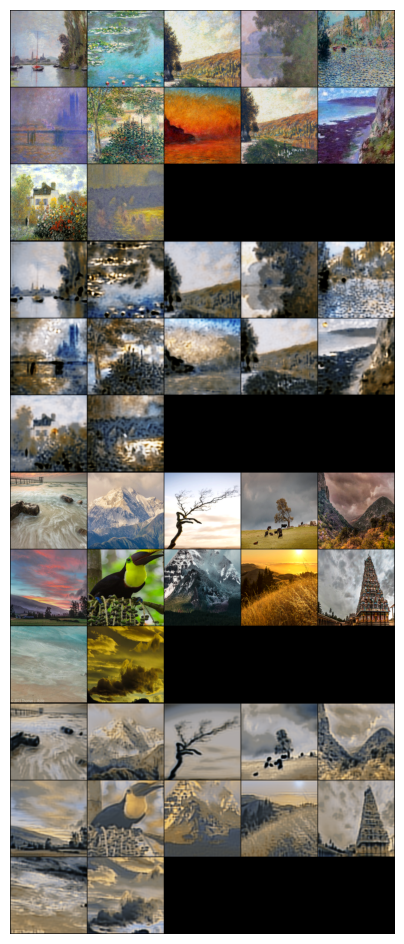

EPOCH: 1.000  loss_D: 0.217  loss_G: 3.838  loss_GAN: 0.375  loss_cycle: 0.237  loss_identity: 0.218  (742.06s - 0.00s remaining)
Starting Epoch 2/24
loss_D: 0.1587  loss_G: 4.5329  loss_GAN: 0.4537  loss_cycle: 0.2878  loss_identity: 0.2402  
Epoch 2: loss_D: 0.1876  loss_G: 4.1856  loss_GAN: 0.4146  loss_cycle: 0.2626  loss_identity: 0.2290  


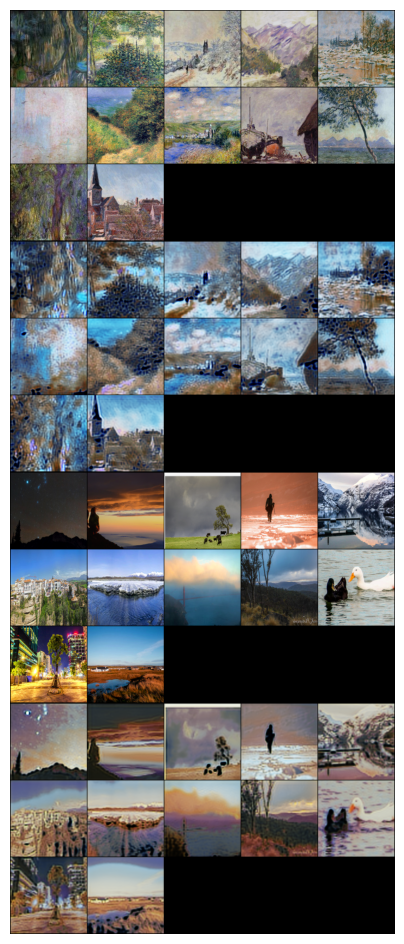

EPOCH: 2.000  loss_D: 0.159  loss_G: 4.533  loss_GAN: 0.454  loss_cycle: 0.288  loss_identity: 0.240  (727.50s - 0.00s remaining)
Starting Epoch 3/24
loss_D: 0.2201  loss_G: 3.3793  loss_GAN: 0.4356  loss_cycle: 0.2038  loss_identity: 0.1812  
Epoch 3: loss_D: 0.1985  loss_G: 3.9168  loss_GAN: 0.4216  loss_cycle: 0.2430  loss_identity: 0.2131  


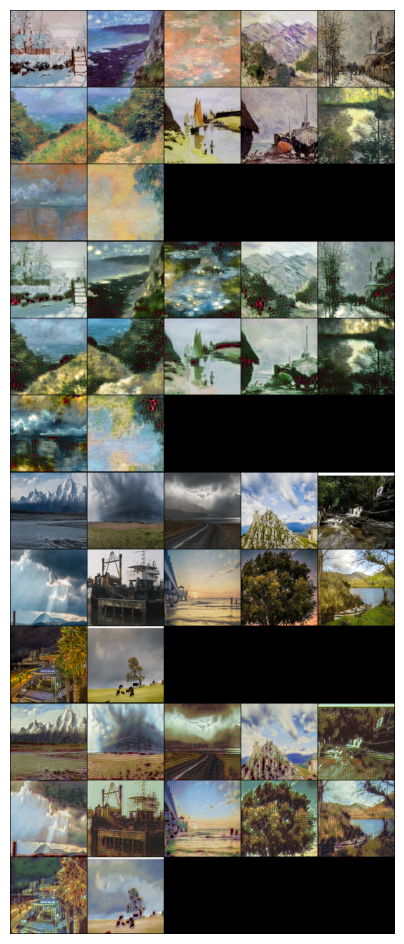

EPOCH: 3.000  loss_D: 0.220  loss_G: 3.379  loss_GAN: 0.436  loss_cycle: 0.204  loss_identity: 0.181  (725.01s - 0.00s remaining)
Starting Epoch 4/24
loss_D: 0.1761  loss_G: 3.5923  loss_GAN: 0.5957  loss_cycle: 0.1993  loss_identity: 0.2008  
Epoch 4: loss_D: 0.1929  loss_G: 3.8357  loss_GAN: 0.4651  loss_cycle: 0.2321  loss_identity: 0.2100  


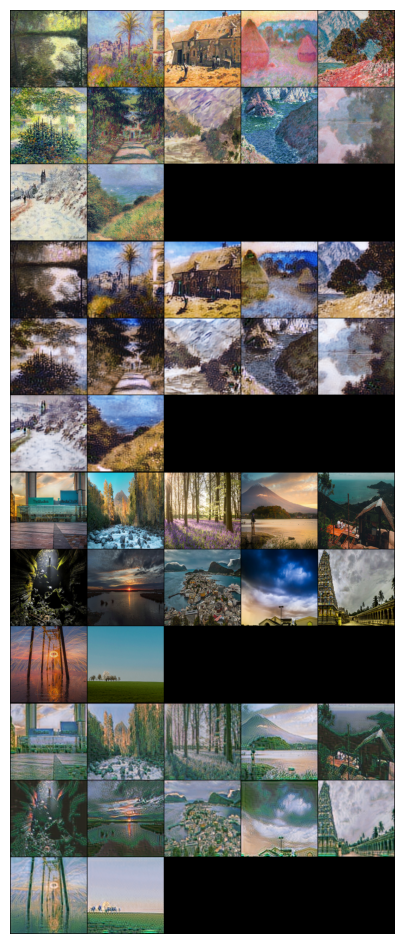

EPOCH: 4.000  loss_D: 0.176  loss_G: 3.592  loss_GAN: 0.596  loss_cycle: 0.199  loss_identity: 0.201  (721.49s - 0.00s remaining)
Starting Epoch 5/24
loss_D: 0.1761  loss_G: 3.9950  loss_GAN: 0.7431  loss_cycle: 0.2226  loss_identity: 0.2052  
Epoch 5: loss_D: 0.1895  loss_G: 3.8675  loss_GAN: 0.5207  loss_cycle: 0.2302  loss_identity: 0.2091  


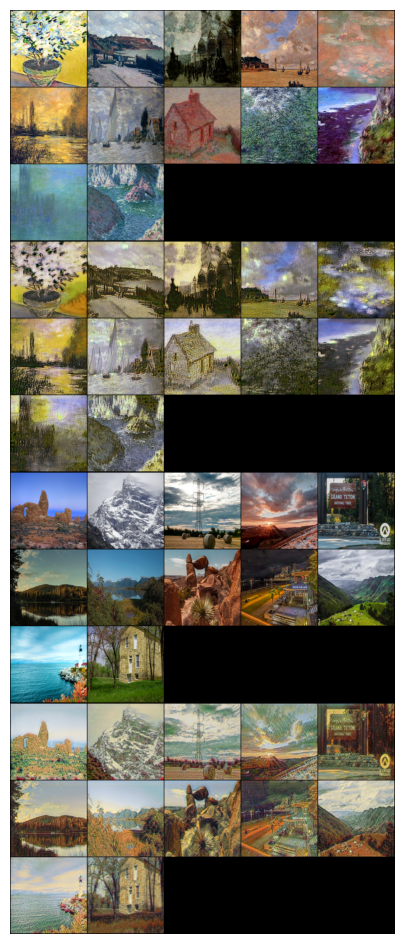

EPOCH: 5.000  loss_D: 0.176  loss_G: 3.995  loss_GAN: 0.743  loss_cycle: 0.223  loss_identity: 0.205  (719.82s - 0.00s remaining)
Starting Epoch 6/24
loss_D: 0.1805  loss_G: 3.0628  loss_GAN: 0.3028  loss_cycle: 0.1851  loss_identity: 0.1817  
Epoch 6: loss_D: 0.1880  loss_G: 3.7334  loss_GAN: 0.4844  loss_cycle: 0.2227  loss_identity: 0.2045  


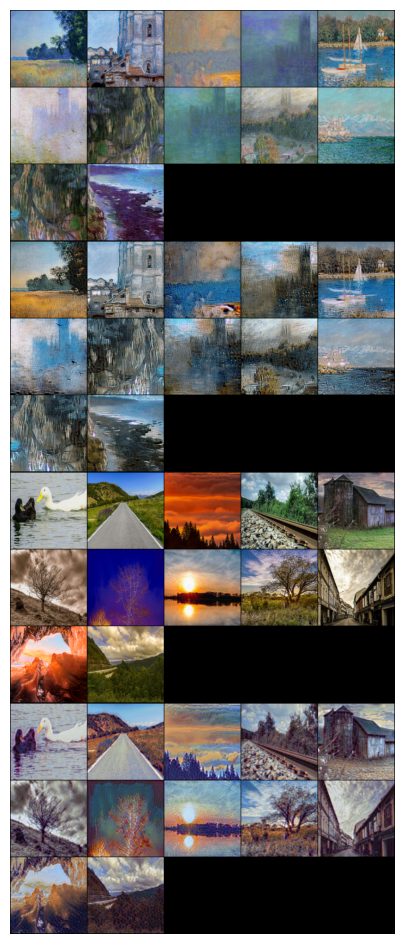

EPOCH: 6.000  loss_D: 0.180  loss_G: 3.063  loss_GAN: 0.303  loss_cycle: 0.185  loss_identity: 0.182  (720.68s - 0.00s remaining)
Starting Epoch 7/24
loss_D: 0.1879  loss_G: 3.4871  loss_GAN: 0.8053  loss_cycle: 0.1806  loss_identity: 0.1751  
Epoch 7: loss_D: 0.1880  loss_G: 3.6982  loss_GAN: 0.5302  loss_cycle: 0.2167  loss_identity: 0.2003  


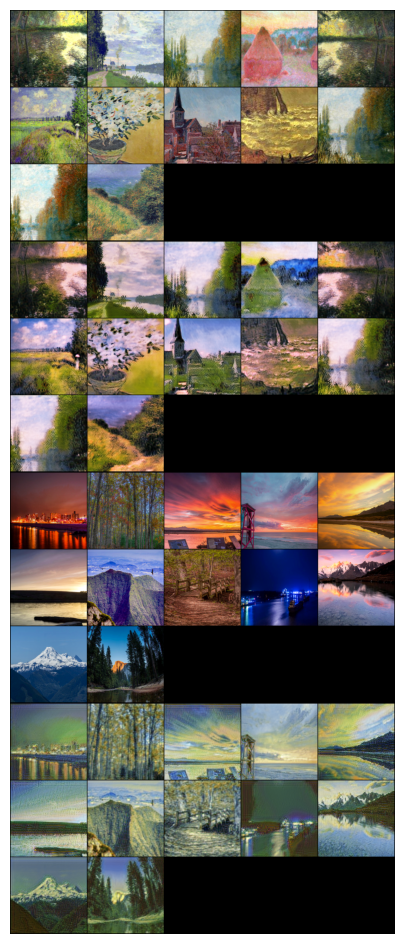

EPOCH: 7.000  loss_D: 0.188  loss_G: 3.487  loss_GAN: 0.805  loss_cycle: 0.181  loss_identity: 0.175  (719.41s - 0.00s remaining)
Starting Epoch 8/24
loss_D: 0.1908  loss_G: 2.9415  loss_GAN: 0.4194  loss_cycle: 0.1699  loss_identity: 0.1646  
Epoch 8: loss_D: 0.1883  loss_G: 3.6036  loss_GAN: 0.5164  loss_cycle: 0.2108  loss_identity: 0.1958  


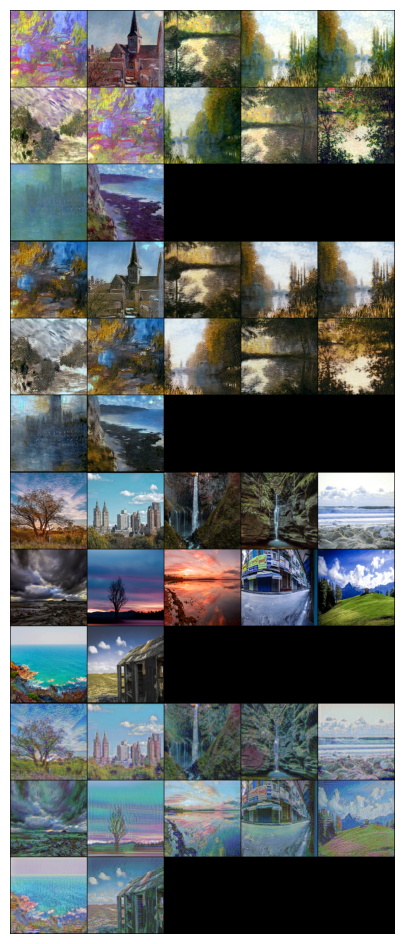

EPOCH: 8.000  loss_D: 0.191  loss_G: 2.941  loss_GAN: 0.419  loss_cycle: 0.170  loss_identity: 0.165  (719.58s - 0.00s remaining)
Starting Epoch 9/24
loss_D: 0.1521  loss_G: 3.2299  loss_GAN: 0.4850  loss_cycle: 0.1872  loss_identity: 0.1745  
Epoch 9: loss_D: 0.1843  loss_G: 3.5621  loss_GAN: 0.5129  loss_cycle: 0.2082  loss_identity: 0.1935  


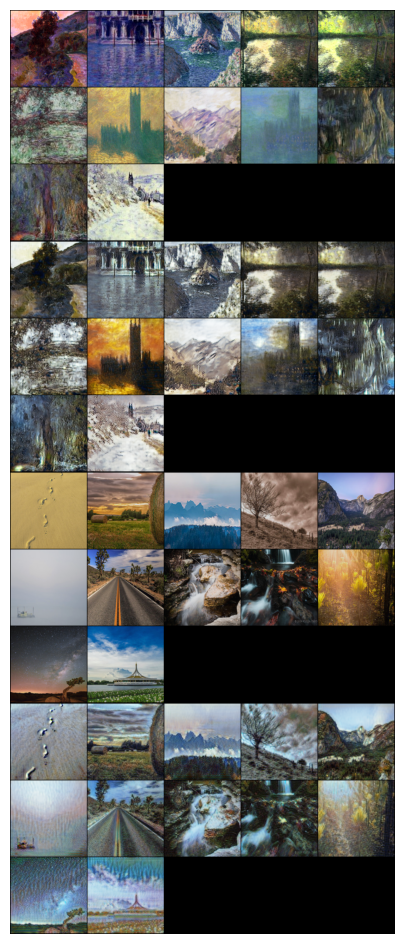

EPOCH: 9.000  loss_D: 0.152  loss_G: 3.230  loss_GAN: 0.485  loss_cycle: 0.187  loss_identity: 0.175  (728.62s - 0.00s remaining)
Starting Epoch 10/24
loss_D: 0.1172  loss_G: 2.9432  loss_GAN: 0.6273  loss_cycle: 0.1574  loss_identity: 0.1484  
Epoch 10: loss_D: 0.1776  loss_G: 3.5002  loss_GAN: 0.5243  loss_cycle: 0.2031  loss_identity: 0.1890  


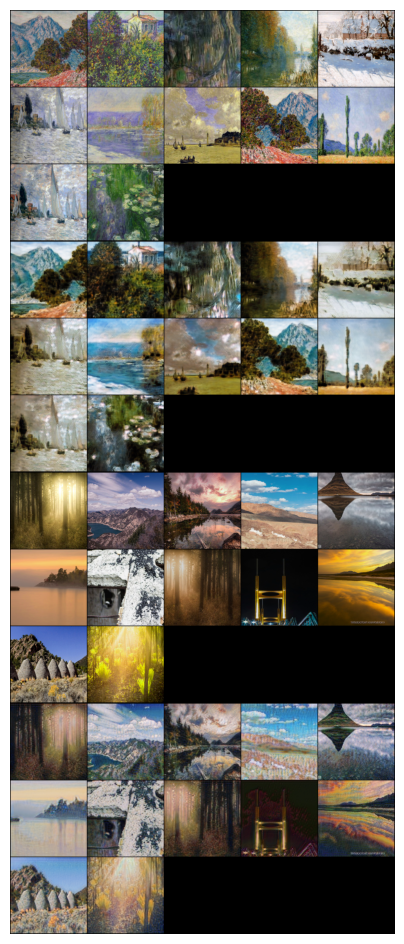

EPOCH: 10.000  loss_D: 0.117  loss_G: 2.943  loss_GAN: 0.627  loss_cycle: 0.157  loss_identity: 0.148  (720.04s - 0.00s remaining)
Starting Epoch 11/24
loss_D: 0.1577  loss_G: 2.9497  loss_GAN: 0.4189  loss_cycle: 0.1738  loss_identity: 0.1585  
Epoch 11: loss_D: 0.1758  loss_G: 3.4502  loss_GAN: 0.5148  loss_cycle: 0.2004  loss_identity: 0.1862  


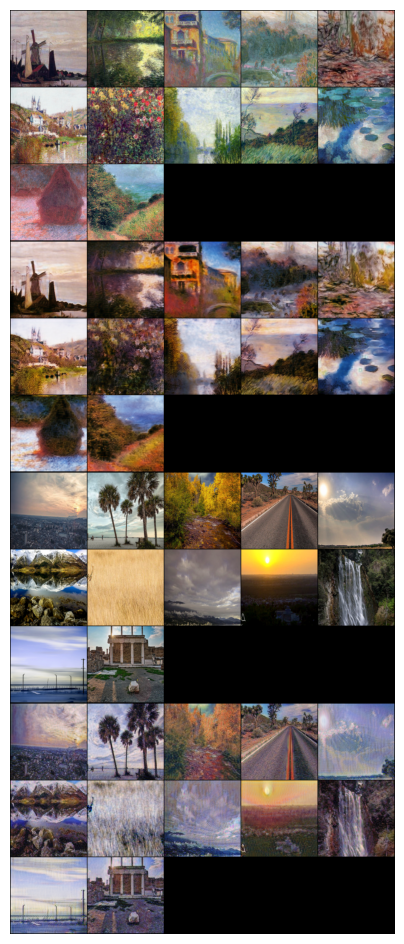

EPOCH: 11.000  loss_D: 0.158  loss_G: 2.950  loss_GAN: 0.419  loss_cycle: 0.174  loss_identity: 0.159  (718.63s - 0.00s remaining)
Starting Epoch 12/24
loss_D: 0.1412  loss_G: 3.1300  loss_GAN: 0.6359  loss_cycle: 0.1822  loss_identity: 0.1344  
Epoch 12: loss_D: 0.1729  loss_G: 3.4235  loss_GAN: 0.5248  loss_cycle: 0.1989  loss_identity: 0.1819  


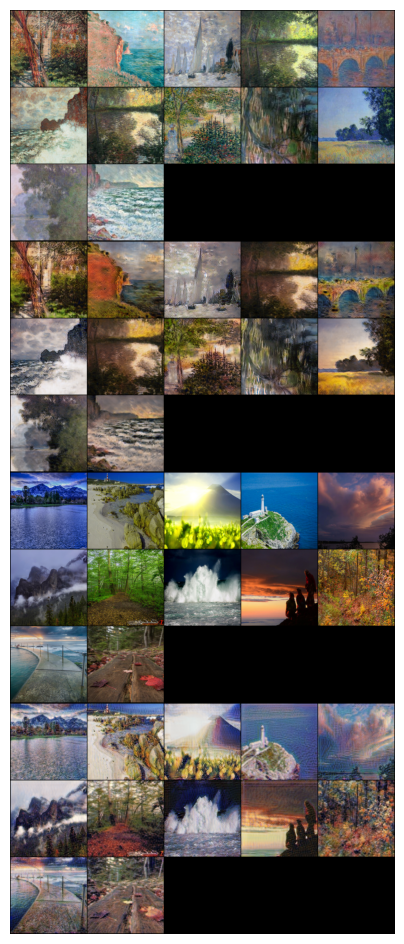

EPOCH: 12.000  loss_D: 0.141  loss_G: 3.130  loss_GAN: 0.636  loss_cycle: 0.182  loss_identity: 0.134  (720.83s - 0.00s remaining)
Starting Epoch 13/24
loss_D: 0.2153  loss_G: 3.7408  loss_GAN: 0.4503  loss_cycle: 0.2206  loss_identity: 0.2169  
Epoch 13: loss_D: 0.1762  loss_G: 3.4479  loss_GAN: 0.5191  loss_cycle: 0.2006  loss_identity: 0.1846  


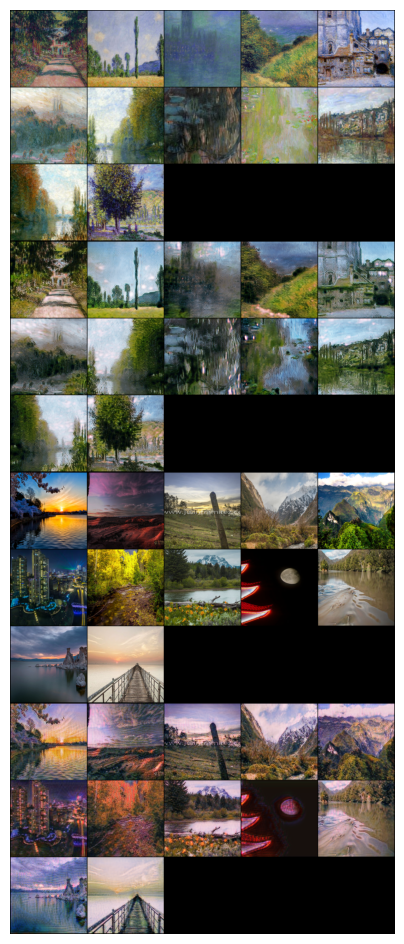

EPOCH: 13.000  loss_D: 0.215  loss_G: 3.741  loss_GAN: 0.450  loss_cycle: 0.221  loss_identity: 0.217  (721.69s - 0.00s remaining)
Starting Epoch 14/24
loss_D: 0.1133  loss_G: 3.0328  loss_GAN: 0.5717  loss_cycle: 0.1594  loss_identity: 0.1733  
Epoch 14: loss_D: 0.1717  loss_G: 3.4183  loss_GAN: 0.5229  loss_cycle: 0.1977  loss_identity: 0.1838  


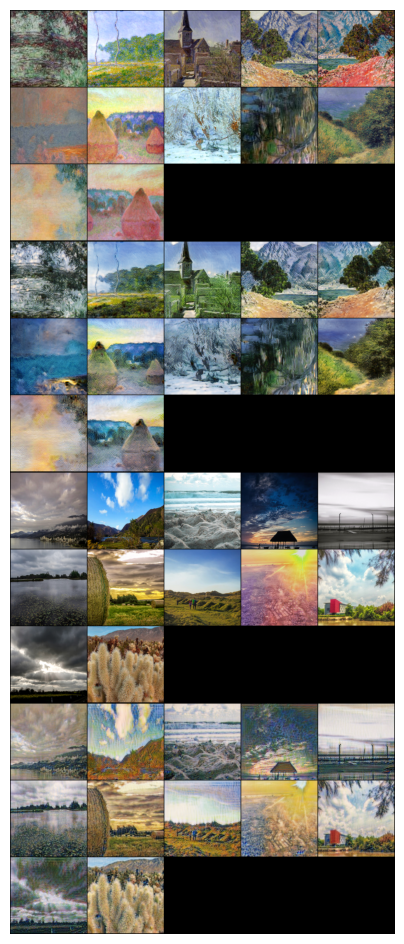

EPOCH: 14.000  loss_D: 0.113  loss_G: 3.033  loss_GAN: 0.572  loss_cycle: 0.159  loss_identity: 0.173  (722.66s - 0.00s remaining)
Starting Epoch 15/24
loss_D: 0.1488  loss_G: 2.7902  loss_GAN: 0.3905  loss_cycle: 0.1638  loss_identity: 0.1524  
Epoch 15: loss_D: 0.1702  loss_G: 3.3764  loss_GAN: 0.5140  loss_cycle: 0.1954  loss_identity: 0.1817  


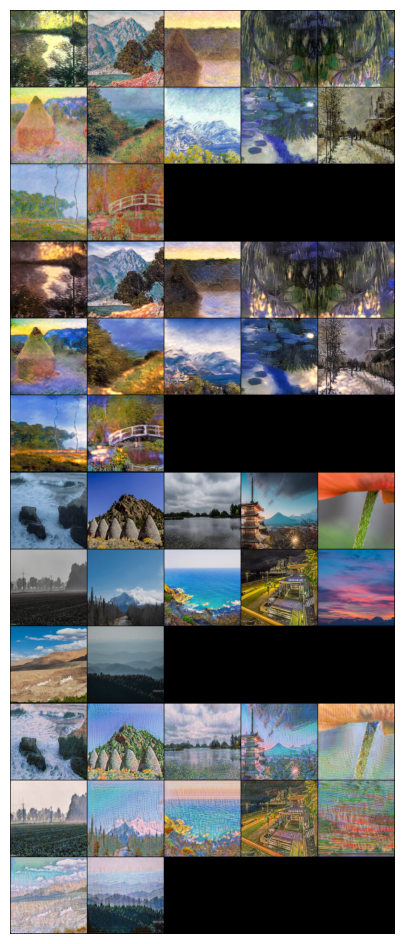

EPOCH: 15.000  loss_D: 0.149  loss_G: 2.790  loss_GAN: 0.390  loss_cycle: 0.164  loss_identity: 0.152  (721.66s - 0.00s remaining)
Starting Epoch 16/24
loss_D: 0.1474  loss_G: 2.6783  loss_GAN: 0.6675  loss_cycle: 0.1344  loss_identity: 0.1334  
Epoch 16: loss_D: 0.1687  loss_G: 3.3328  loss_GAN: 0.5236  loss_cycle: 0.1916  loss_identity: 0.1787  


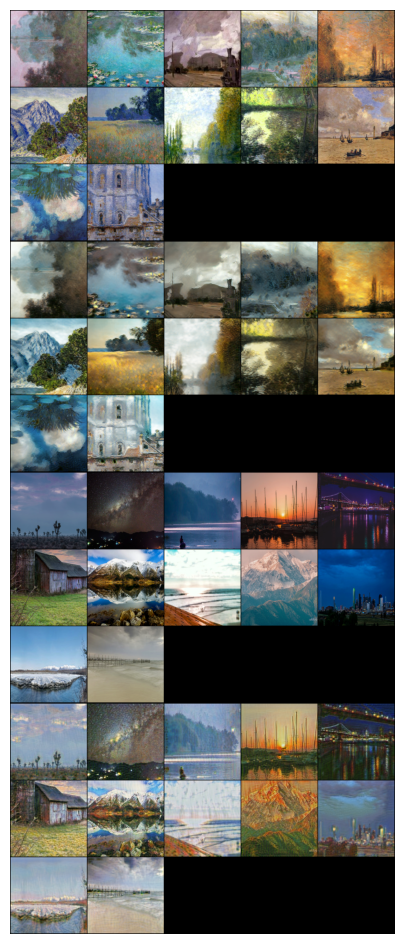

EPOCH: 16.000  loss_D: 0.147  loss_G: 2.678  loss_GAN: 0.667  loss_cycle: 0.134  loss_identity: 0.133  (728.55s - 0.00s remaining)
Starting Epoch 17/24
loss_D: 0.1313  loss_G: 2.7328  loss_GAN: 0.4188  loss_cycle: 0.1570  loss_identity: 0.1488  
Epoch 17: loss_D: 0.1665  loss_G: 3.2975  loss_GAN: 0.5175  loss_cycle: 0.1895  loss_identity: 0.1769  


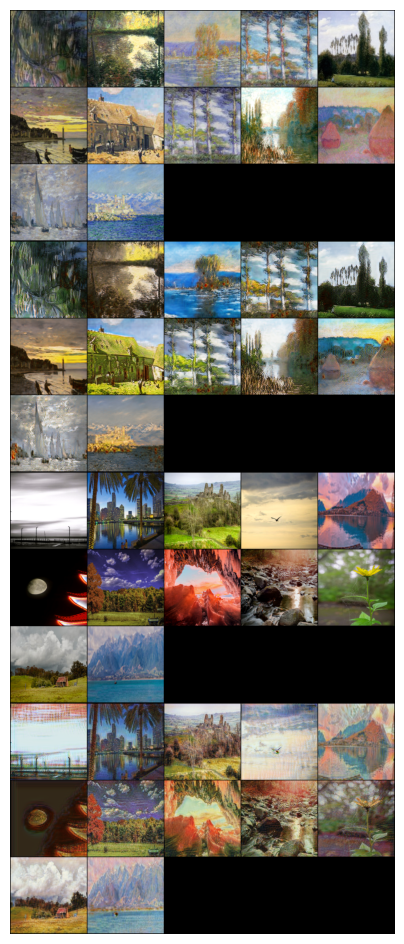

EPOCH: 17.000  loss_D: 0.131  loss_G: 2.733  loss_GAN: 0.419  loss_cycle: 0.157  loss_identity: 0.149  (720.14s - 0.00s remaining)
Starting Epoch 18/24
loss_D: 0.1461  loss_G: 2.9364  loss_GAN: 0.6303  loss_cycle: 0.1566  loss_identity: 0.1479  
Epoch 18: loss_D: 0.1654  loss_G: 3.2774  loss_GAN: 0.5237  loss_cycle: 0.1877  loss_identity: 0.1753  


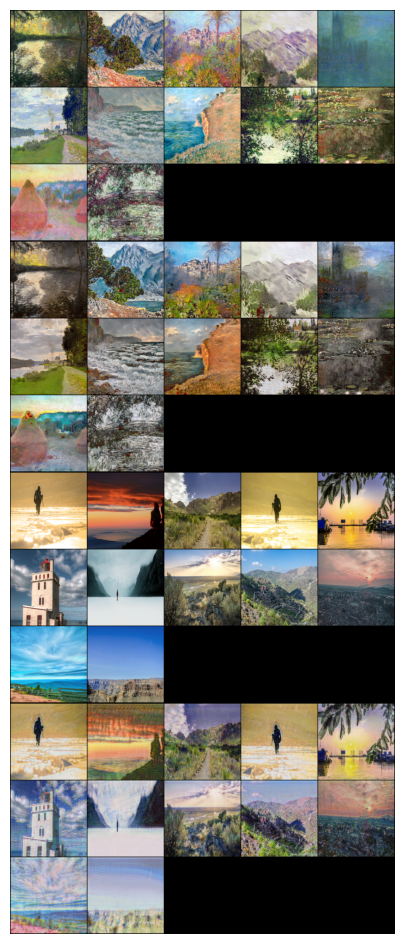

EPOCH: 18.000  loss_D: 0.146  loss_G: 2.936  loss_GAN: 0.630  loss_cycle: 0.157  loss_identity: 0.148  (719.09s - 0.00s remaining)
Starting Epoch 19/24
loss_D: 0.1587  loss_G: 2.4235  loss_GAN: 0.4398  loss_cycle: 0.1350  loss_identity: 0.1268  
Epoch 19: loss_D: 0.1650  loss_G: 3.2325  loss_GAN: 0.5193  loss_cycle: 0.1849  loss_identity: 0.1727  


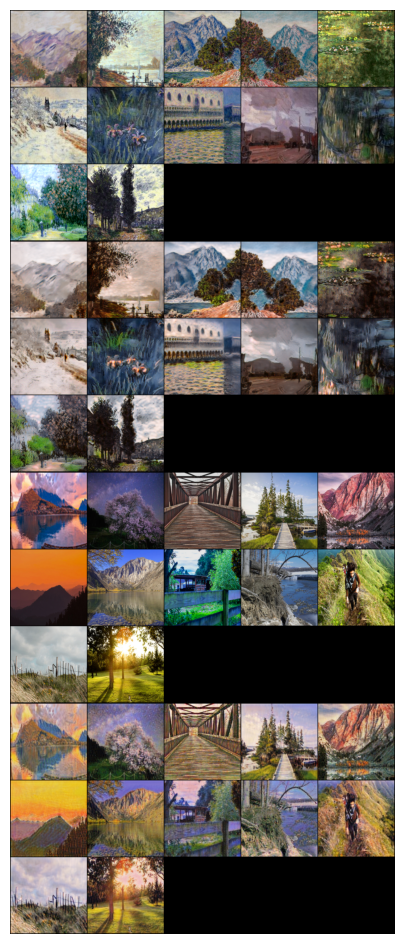

EPOCH: 19.000  loss_D: 0.159  loss_G: 2.424  loss_GAN: 0.440  loss_cycle: 0.135  loss_identity: 0.127  (722.25s - 0.00s remaining)
Starting Epoch 20/24
loss_D: 0.1548  loss_G: 2.6985  loss_GAN: 0.5615  loss_cycle: 0.1464  loss_identity: 0.1346  
Epoch 20: loss_D: 0.1645  loss_G: 3.2058  loss_GAN: 0.5214  loss_cycle: 0.1830  loss_identity: 0.1708  


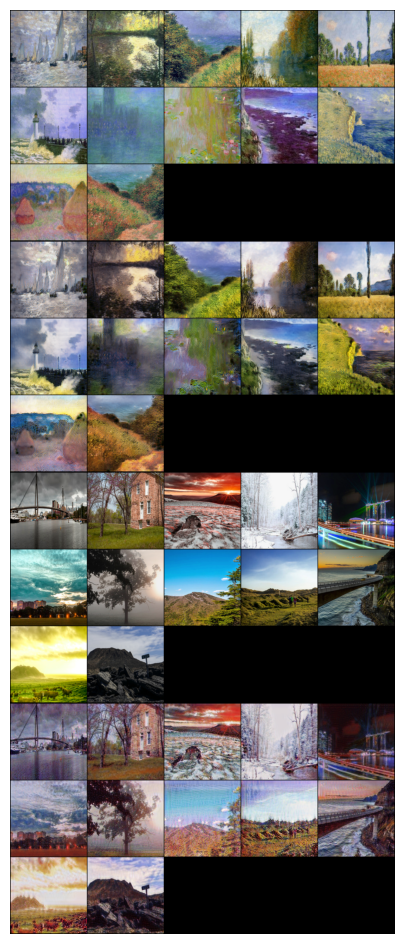

EPOCH: 20.000  loss_D: 0.155  loss_G: 2.699  loss_GAN: 0.561  loss_cycle: 0.146  loss_identity: 0.135  (724.19s - 0.00s remaining)
Starting Epoch 21/24
loss_D: 0.1591  loss_G: 2.6269  loss_GAN: 0.6198  loss_cycle: 0.1368  loss_identity: 0.1278  
Epoch 21: loss_D: 0.1643  loss_G: 3.1782  loss_GAN: 0.5261  loss_cycle: 0.1808  loss_identity: 0.1688  


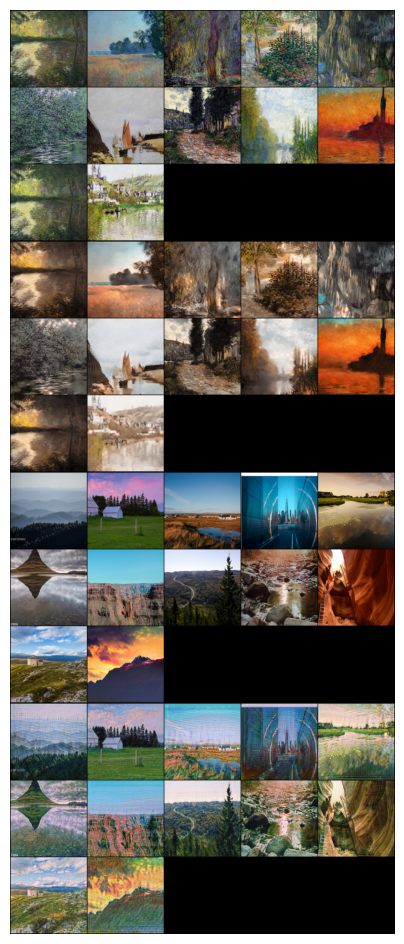

EPOCH: 21.000  loss_D: 0.159  loss_G: 2.627  loss_GAN: 0.620  loss_cycle: 0.137  loss_identity: 0.128  (721.65s - 0.00s remaining)
Starting Epoch 22/24
loss_D: 0.1448  loss_G: 2.6645  loss_GAN: 0.5391  loss_cycle: 0.1421  loss_identity: 0.1410  
Epoch 22: loss_D: 0.1634  loss_G: 3.1548  loss_GAN: 0.5267  loss_cycle: 0.1791  loss_identity: 0.1675  


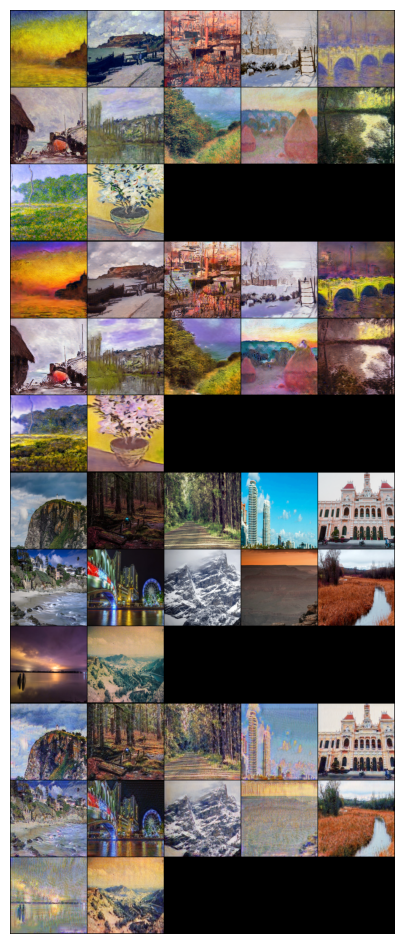

EPOCH: 22.000  loss_D: 0.145  loss_G: 2.664  loss_GAN: 0.539  loss_cycle: 0.142  loss_identity: 0.141  (724.34s - 0.00s remaining)
Starting Epoch 23/24
loss_D: 0.1663  loss_G: 2.7028  loss_GAN: 0.4678  loss_cycle: 0.1487  loss_identity: 0.1496  
Epoch 23: loss_D: 0.1635  loss_G: 3.1352  loss_GAN: 0.5241  loss_cycle: 0.1777  loss_identity: 0.1667  


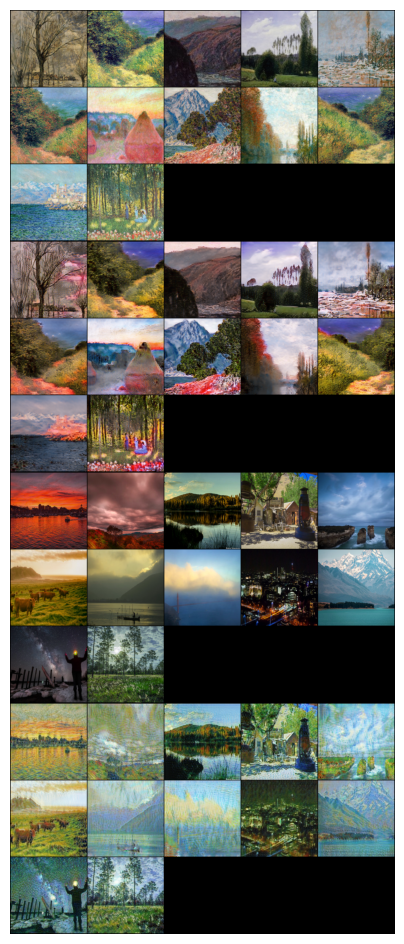

EPOCH: 23.000  loss_D: 0.166  loss_G: 2.703  loss_GAN: 0.468  loss_cycle: 0.149  loss_identity: 0.150  (724.99s - 0.00s remaining)
Starting Epoch 24/24
loss_D: 0.1869  loss_G: 2.7294  loss_GAN: 0.5150  loss_cycle: 0.1530  loss_identity: 0.1369  
Epoch 24: loss_D: 0.1645  loss_G: 3.1183  loss_GAN: 0.5238  loss_cycle: 0.1767  loss_identity: 0.1655  


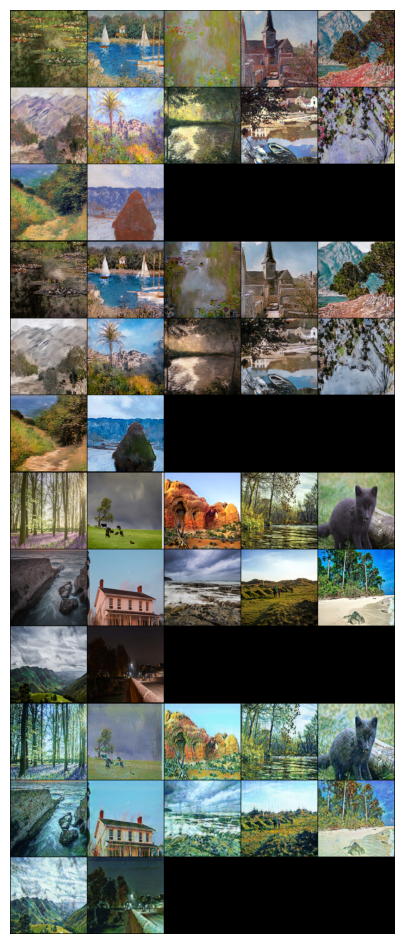

EPOCH: 24.000  loss_D: 0.187  loss_G: 2.729  loss_GAN: 0.515  loss_cycle: 0.153  loss_identity: 0.137  (723.97s - 0.00s remaining)


In [18]:
n_epochs = 24
log = Report(n_epochs)

for epoch in range(n_epochs):
    start_time = time.time()  # Start time for tracking duration
    N = len(train_dataloader)
    #print(f'N-{N}')
    print(f"Starting Epoch {epoch + 1}/{n_epochs}")
    print("=" * 60)
    
    for bx, batch in enumerate(train_dataloader):
        real_A, real_B = batch
        #print(f'bx-{bx}')
        # print(batch)

        loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B = generator_train_step((G_AB, G_BA), optimizer_G, real_A, real_B)
        loss_D_A = discriminator_train_step(D_A, real_A, fake_A, optimizer_D_A)
        loss_D_B = discriminator_train_step(D_B, real_B, fake_B, optimizer_D_B)
        loss_D = (loss_D_A + loss_D_B) / 2
        # print(f'loss_D_A-{loss_D_A}')
        elapsed_time = time.time() - start_time
        remaining_time = (elapsed_time / (bx + 1)) * (N - (bx + 1))

    log.record(epoch + (1 + bx) / N,
                loss_D=loss_D.item(),
                loss_G=loss_G.item(),
                loss_GAN=loss_GAN.item(),
                loss_cycle=loss_cycle.item(),
                loss_identity=loss_identity.item(),
                end='\r')

    log.report_avgs(epoch + 1)

    generate_sample()

    print(f"EPOCH: {epoch + 1:.3f}  loss_D: {loss_D.item():.3f}  loss_G: {loss_G.item():.3f}  loss_GAN: {loss_GAN.item():.3f}  "
          f"loss_cycle: {loss_cycle.item():.3f}  loss_identity: {loss_identity.item():.3f}  "
          f"({elapsed_time:.2f}s - {remaining_time:.2f}s remaining)")
    print("=" * 60)

<b> <font color = 'blue'> Plotting the metrics </b>

In [19]:
def plot_epochs(report, keys=None):
    if keys is None:
        keys = list(report.losses.keys())

    epochs = range(1, len(next(iter(report.losses.values()))) + 1)
    plt.figure(figsize=(10, 6))
    
    for key in keys:
        if key in report.losses and report.losses[key]:
            plt.plot(epochs, report.losses[key], label=key)

    plt.xlabel('Epochs')
    plt.ylabel('Metrics')
    plt.title('Training Metrics over Epochs')
    plt.legend()
    plt.grid(True)
    plt.show()

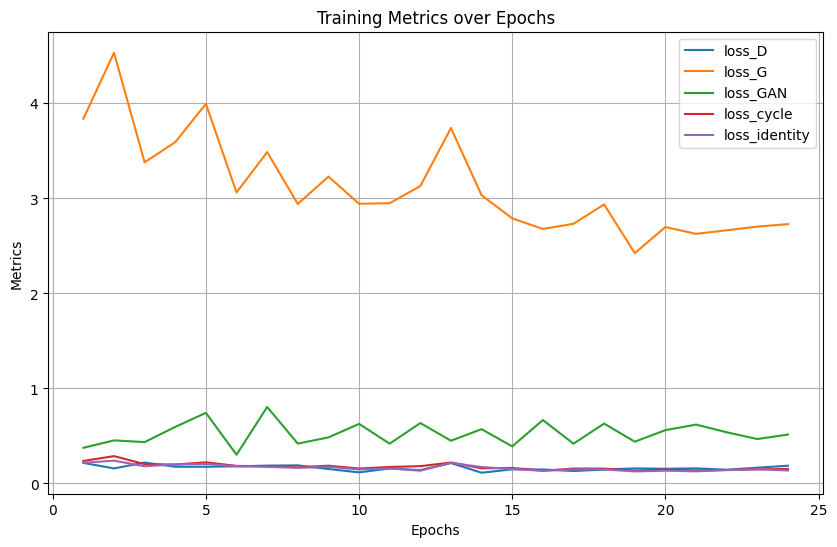

In [20]:
plot_epochs(log)

<font color = 'blue'>1.	Generator Loss (loss_G): This value, which starts high and gradually decreases, indicates that the generator is learning to create more realistic photos. The ups and downs show that the process is still fine-tuning.\
<font color = 'blue'>2.	Discriminator Loss (loss_D): This loss remains low and steady, meaning the discriminator is consistently good at telling real photos from generated ones.\
<font color = 'blue'>3.	GAN Loss (loss_GAN): The low and stable GAN loss shows a balanced competition between the generator and discriminator, where the generated photos are becoming convincingly real.\
<font color = 'blue'>4.	Cycle Loss (loss_cycle): Staying close to zero, this loss signifies that the model is doing well in ensuring that a Monet painting can be converted to a photo and back without losing its essence.\
<font color = 'blue'>5.	Identity Loss (loss_identity): Also low and stable, this loss indicates that the model is preserving the original style of images that shouldn’t change.

<font color = 'blue'>Overall, the training is progressing well. The generator is improving, and the model is maintaining important features in the images. We will review the performance of our model outside of a training set image.

<b> <font color = 'blue'>Saving the model</b>

In [21]:
model_save_path_G_AB = 'G_AB.pth'
model_save_path_G_BA = 'G_BA.pth'
model_save_path_D_A = 'D_A.pth'
model_save_path_D_B = 'D_B.pth'

# Save the model state dictionaries

torch.save(G_AB.state_dict(), model_save_path_G_AB)
torch.save(G_BA.state_dict(), model_save_path_G_BA)
torch.save(D_A.state_dict(), model_save_path_D_A)
torch.save(D_B.state_dict(), model_save_path_D_B)

print("Models saved successfully.")

Models saved successfully.


In [22]:
torch.save(optimizer_G.state_dict(), 'optimizer_G.pth')
torch.save(optimizer_D_A.state_dict(), 'optimizer_D_A.pth')
torch.save(optimizer_D_B.state_dict(), 'optimizer_D_B.pth')

### <font color = 'purple'> 4) load your favorite image (or your picture) apply Cyclegan and upload it with the report

<font color = 'blue'> We will load the saved model to perform this part.

<font color = 'blue'> Initializing the generator and discriminator classes again.

In [18]:
G_AB = GeneratorResNet().to(device)
G_BA = GeneratorResNet().to(device)
D_A = Discriminator().to(device)
D_B = Discriminator().to(device)

In [19]:
model_save_path_G_AB = '/kaggle/input/testcyclegan/G_AB.pth'
model_save_path_G_BA = '/kaggle/input/testcyclegan/G_BA.pth'
model_save_path_D_A = '/kaggle/input/testcyclegan/D_A.pth'
model_save_path_D_B = '/kaggle/input/testcyclegan/D_B.pth'

<font color='blue'> Loading saved states for Generator and Discriminator

In [20]:
G_AB.load_state_dict(torch.load(model_save_path_G_AB))
G_BA.load_state_dict(torch.load(model_save_path_G_BA))
D_A.load_state_dict(torch.load(model_save_path_D_A))
D_B.load_state_dict(torch.load(model_save_path_D_B))

/tmp/ipykernel_30/2300035620.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  G_AB.load_state_dict(torch.load(model_save_path_G_AB))
/tmp/ipykernel_30/2300035620.py:2: Fu

<All keys matched successfully>

<font color = 'blue'>Creating optimizer again as the earlier ones cannot be run again

In [21]:
optimizer_G = torch.optim.Adam(
    itertools.chain(G_AB.parameters(), G_BA.parameters()), lr=0.0002, betas=(0.5, 0.999)
)

optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

lambda_cyc, lambda_id = 10.0, 5.0

<font color='blue'> Loading saved states for Optimizer

In [22]:
optimizer_G.load_state_dict(torch.load('/kaggle/input/testcyclegan/optimizer_G.pth'))
optimizer_D_A.load_state_dict(torch.load('/kaggle/input/testcyclegan/optimizer_D_A.pth'))
optimizer_D_B.load_state_dict(torch.load('/kaggle/input/testcyclegan/optimizer_D_B.pth'))

/tmp/ipykernel_30/1256826345.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  optimizer_G.load_state_dict(torch.load('/kaggle/input/testcyclegan/optimizer_G.pth'))
/tmp/i

<font color='blue'> Running CycleGAN on a random image from internet

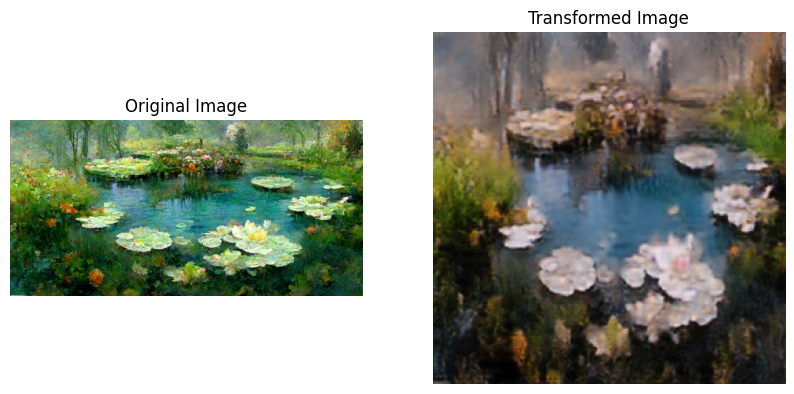

Transformed image saved at transformed_image.jpg


In [25]:
G_AB.eval()

image_path ='/kaggle/input/testcyclegan/testImage.jpeg'
image = Image.open(image_path).convert('RGB')

transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

input_image = transform(image).unsqueeze(0).to(device)

with torch.no_grad():
    fake_image =G_AB(input_image)
    fake_image = fake_image.cpu()  # Move back to CPU

fake_image = fake_image.squeeze(0)
fake_image = (fake_image * 0.5 + 0.5)
fake_image = fake_image.permute(1, 2, 0)
fake_image = (fake_image * 255).byte().numpy()

output_image_path ='transformed_image.jpg'
Image.fromarray(fake_image).save(output_image_path)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(image)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Transformed Image')
plt.imshow(fake_image)
plt.axis('off')

plt.show()

print(f'Transformed image saved at {output_image_path}')

<font color = 'blue'> Transformed Image is attached.

## <font color = 'blue'> Thank You!

Part 2 - DCGAN in different IPYNB